In [92]:
from snowflake.snowpark import Session
from snowflake.snowpark.functions import col, year, month, dayofmonth
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
import pandas as pd
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, mean_squared_error
from sklearn.cluster import KMeans
from math import sqrt
import matplotlib.pyplot as plt
import seaborn as sns
import re
import numpy as np

In [93]:
#Connect to Snowflake
connection_parameters = {
    "account": "TVGXNVI-AGB54091",
    "user": "MIHITHA",
    "password": "MihithaChirangi@2001",
    "role": "ACCOUNTADMIN",
    "warehouse": "COMPUTE_WH",
    "database": "SALES_DB",
    "schema": "STARSCHEMA"
}
session = Session.builder.configs(connection_parameters).create()

In [94]:
#Load fact and dimension tables
fact_sales = session.table("FACTSALES")
dim_date = session.table("DIMDATE")
dim_customer = session.table("DIMCUSTOMER")
dim_product = session.table("DIMPRODUCT")
dim_shipping = session.table("DIMSHIPPING")
dim_location = session.table("DIMLOCATION")


#### 1. Predict Shipment Status

In [95]:
# Load necessary columns from star schema
def load_shipment_data():
    df = fact_sales.join(dim_date, fact_sales["ORDERDATEKEY"] == dim_date["DATEKEY"]) \
                   .join(dim_customer, fact_sales["CUSTOMERKEY"] == dim_customer["CUSTOMERKEY"]) \
                   .join(dim_product, fact_sales["PRODUCTKEY"] == dim_product["PRODUCTKEY"]) \
                   .join(dim_shipping, fact_sales["SHIPMODEKEY"] == dim_shipping["SHIPMODEKEY"]) \
                   .join(dim_location, fact_sales["LOCATIONKEY"] == dim_location["LOCATIONKEY"]) \
                   .select(
                        fact_sales["FACTID"],
                        fact_sales["SALES"],
                        fact_sales["QUANTITY"],
                        fact_sales["DISCOUNT"],
                        fact_sales["PROFIT"],
                        dim_customer['SEGMENT'],
                        dim_shipping["SHIPMODE"],
                        dim_shipping["SHIPSTATUS"],
                        dim_product["CATEGORY"],
                        dim_location["REGION"],                  
                        dim_location["STATE"],
                        dim_date["MONTH"],
                        dim_date["YEAR"],
                        dim_location["LATITUDE"],
                        dim_location["LONGITUDE"]
                )
    return df.to_pandas()



In [96]:
shipment_data = load_shipment_data()
shipment_data = shipment_data.drop_duplicates(subset=["FACTID"])
shipment_data

,FACTID,SALES,QUANTITY,DISCOUNT,PROFIT,SEGMENT,SHIPMODE,SHIPSTATUS,CATEGORY,REGION,STATE,MONTH,YEAR,LATITUDE,LONGITUDE
0,1,16.0,2,0.2,6.0,Consumer,Standard Class,Shipped Early,Office Supplies,Central,Texas,1,2011,29.8941,-95.6481
1,2,12.0,3,0.2,4.0,Home Office,Standard Class,Shipped Early,Office Supplies,Central,Illinois,1,2011,41.7662,-88.1410
2,3,4.0,2,0.8,-5.0,Home Office,Standard Class,Shipped Early,Office Supplies,Central,Illinois,1,2011,41.7662,-88.1410
3,4,273.0,3,0.2,-65.0,Home Office,Standard Class,Shipped Early,Office Supplies,Central,Illinois,1,2011,41.7662,-88.1410
4,5,20.0,3,0.2,5.0,Consumer,Standard Class,Shipped Late,Office Supplies,East,Pennsylvania,1,2011,39.9448,-75.2288
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9988,13353,14.0,2,0.2,5.0,Corporate,Standard Class,Shipped Early,Office Supplies,West,California,12,2014,38.2671,-122.0357
9989,13354,21.0,2,0.2,6.0,Corporate,Standard Class,Shipped Early,Office Supplies,West,California,12,2014,38.2671,-122.0357
9990,13355,3.0,3,0.2,-1.0,Consumer,Standard Class,Shipped Early,Office Supplies,West,Colorado,12,2014,40.4262,-105.0900
9991,13356,53.0,3,0.2,20.0,Consumer,Standard Class,Shipped Early,Office Supplies,East,New York,12,2014,40.7262,-73.9796


In [97]:
shipment_data.columns

Index(['FACTID', 'SALES', 'QUANTITY', 'DISCOUNT', 'PROFIT', 'SEGMENT',
       'SHIPMODE', 'SHIPSTATUS', 'CATEGORY', 'REGION', 'STATE', 'MONTH',
       'YEAR', 'LATITUDE', 'LONGITUDE'],
      dtype='object')

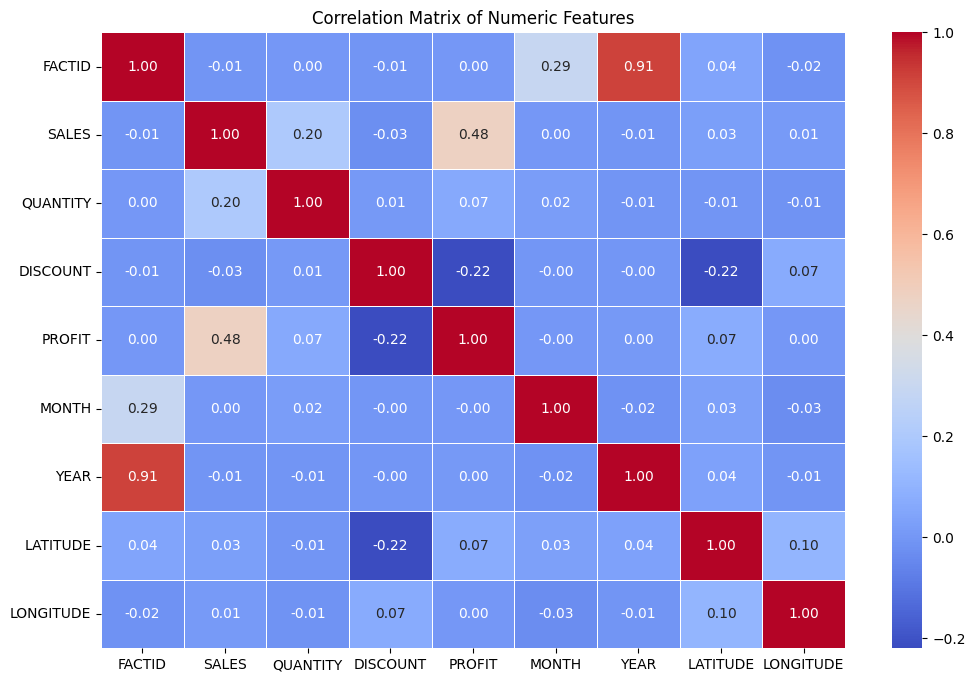

In [98]:
# correlation matrix
numeric_data = shipment_data.select_dtypes(include=[np.number])

correlation_matrix = numeric_data.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix of Numeric Features")
plt.show()


In [99]:
#One-hot encoding
for col in shipment_data.select_dtypes(include=['datetime', 'datetime64']):
    shipment_data[col] = shipment_data[col].astype(np.int64) 
    
X = pd.get_dummies(shipment_data.drop(['FACTID','SHIPSTATUS'], axis ='columns'), dtype = int )

#Label Encoding
le = LabelEncoder()
y = le.fit_transform(shipment_data['SHIPSTATUS'])

In [100]:
X

,SALES,QUANTITY,DISCOUNT,PROFIT,MONTH,YEAR,LATITUDE,LONGITUDE,SEGMENT_Consumer,SEGMENT_Corporate,...,STATE_South Dakota,STATE_Tennessee,STATE_Texas,STATE_Utah,STATE_Vermont,STATE_Virginia,STATE_Washington,STATE_West Virginia,STATE_Wisconsin,STATE_Wyoming
0,16.0,2,0.2,6.0,1,2011,29.8941,-95.6481,1,0,...,0,0,1,0,0,0,0,0,0,0
1,12.0,3,0.2,4.0,1,2011,41.7662,-88.1410,0,0,...,0,0,0,0,0,0,0,0,0,0
2,4.0,2,0.8,-5.0,1,2011,41.7662,-88.1410,0,0,...,0,0,0,0,0,0,0,0,0,0
3,273.0,3,0.2,-65.0,1,2011,41.7662,-88.1410,0,0,...,0,0,0,0,0,0,0,0,0,0
4,20.0,3,0.2,5.0,1,2011,39.9448,-75.2288,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9988,14.0,2,0.2,5.0,12,2014,38.2671,-122.0357,0,1,...,0,0,0,0,0,0,0,0,0,0
9989,21.0,2,0.2,6.0,12,2014,38.2671,-122.0357,0,1,...,0,0,0,0,0,0,0,0,0,0
9990,3.0,3,0.2,-1.0,12,2014,40.4262,-105.0900,1,0,...,0,0,0,0,0,0,0,0,0,0
9991,53.0,3,0.2,20.0,12,2014,40.7262,-73.9796,1,0,...,0,0,0,0,0,0,0,0,0,0


In [101]:

y

array([0, 0, 0, ..., 0, 0, 0])

In [102]:
# Standardization
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [103]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42)

In [104]:
# train the model 
model = RandomForestClassifier(n_estimators=100,random_state=42,max_depth=10000000)
model.fit(X_train,y_train)

RandomForestClassifier(max_depth=10000000, random_state=42)

In [105]:
#Evaluation metrics
y_predict = model.predict(X_test)
print("Accuracy:", accuracy_score(y_test, y_predict))
print("\nClassification Report:")
print(classification_report(y_test, y_predict))

Accuracy: 0.728152101400934

Classification Report:
              precision    recall  f1-score   support

           0       0.71      0.93      0.81      1465
           1       0.72      0.69      0.70       786
           2       0.84      0.37      0.52       747

    accuracy                           0.73      2998
   macro avg       0.76      0.66      0.68      2998
weighted avg       0.75      0.73      0.71      2998



#### 2. Predict Sales Forecast

In [106]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

In [107]:
def load_sales_forecast_data():
    df = fact_sales.join(dim_customer, fact_sales["CUSTOMERKEY"] == dim_customer["CUSTOMERKEY"]) \
                   .join(dim_product, fact_sales["PRODUCTKEY"] == dim_product["PRODUCTKEY"]) \
                   .join(dim_shipping, fact_sales["SHIPMODEKEY"] == dim_shipping["SHIPMODEKEY"]) \
                   .join(dim_location, fact_sales["LOCATIONKEY"] == dim_location["LOCATIONKEY"]) \
                   .select(
                        
                        fact_sales["SALESFORECAST"],
                        fact_sales["Sales"],
                        fact_sales["QUANTITY"],
                        fact_sales["DISCOUNT"],
                        fact_sales["PROFIT"],
                        fact_sales["SALESPERCUSTOMER"],
                        fact_sales["PROFITRATIO"],
                        fact_sales["ORDERPROFITABLE"],
                        dim_customer["SEGMENT"],
                        dim_product["CATEGORY"],
                        dim_product["SUBCATEGORY"],
                        dim_location["REGION"],
                        dim_location["STATE"],
                        dim_shipping["SHIPMODE"]
                    ) \
                   .filter(fact_sales["SALESFORECAST"].is_not_null())

    return df.to_pandas()


In [108]:
forecast_data = load_sales_forecast_data()

In [109]:
forecast_data

,SALESFORECAST,SALES,QUANTITY,DISCOUNT,PROFIT,SALESPERCUSTOMER,PROFITRATIO,ORDERPROFITABLE,SEGMENT,CATEGORY,SUBCATEGORY,REGION,STATE,SHIPMODE
0,22.0,16.0,2,0.2,6.0,16.45,33.8,True,Consumer,Office Supplies,Paper,Central,Texas,Standard Class
1,15.0,12.0,3,0.2,4.0,11.78,36.3,True,Home Office,Office Supplies,Labels,Central,Illinois,Standard Class
2,5.0,4.0,2,0.8,-5.0,3.54,-155.0,False,Home Office,Office Supplies,Binders,Central,Illinois,Standard Class
3,357.0,273.0,3,0.2,-65.0,272.74,-23.8,False,Home Office,Office Supplies,Storage,Central,Illinois,Standard Class
4,26.0,20.0,3,0.2,5.0,19.54,25.0,True,Consumer,Office Supplies,Art,East,Pennsylvania,Standard Class
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9988,18.0,14.0,2,0.2,5.0,13.90,32.5,True,Corporate,Office Supplies,Binders,West,California,Standard Class
9989,27.0,21.0,2,0.2,6.0,20.72,31.3,True,Corporate,Office Supplies,Binders,West,California,Standard Class
9990,4.0,3.0,3,0.2,-1.0,3.02,-20.0,False,Consumer,Office Supplies,Fasteners,West,Colorado,Standard Class
9991,69.0,53.0,3,0.2,20.0,52.78,37.5,True,Consumer,Office Supplies,Binders,East,New York,Standard Class


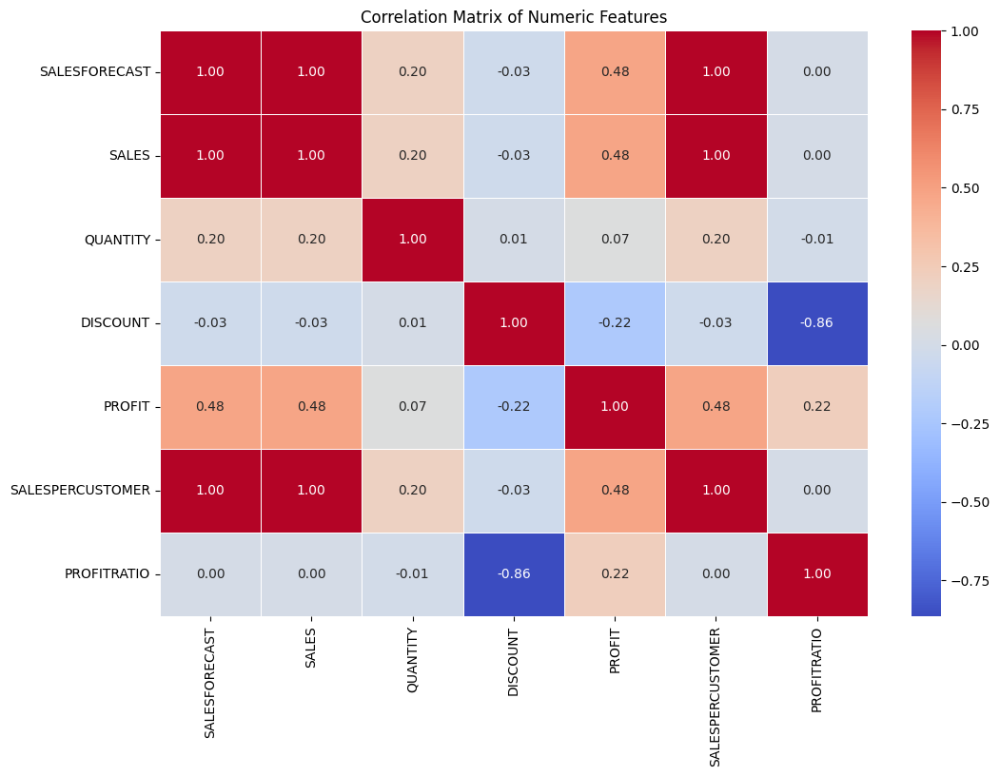

In [110]:
# COrrelation matrix
numeric_data = forecast_data.select_dtypes(include=[np.number])

correlation_matrix = numeric_data.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix of Numeric Features")
plt.show()


In [111]:
forecast_data = forecast_data.drop(['SALESPERCUSTOMER'], axis=1)

In [112]:
# One hot Encoding
X = pd.get_dummies(forecast_data.drop(['SALESFORECAST'], axis ='columns'), dtype = int )
y = forecast_data['SALESFORECAST']

In [113]:
X

,SALES,QUANTITY,DISCOUNT,PROFIT,PROFITRATIO,ORDERPROFITABLE,SEGMENT_Consumer,SEGMENT_Corporate,SEGMENT_Home Office,CATEGORY_Furniture,...,STATE_Vermont,STATE_Virginia,STATE_Washington,STATE_West Virginia,STATE_Wisconsin,STATE_Wyoming,SHIPMODE_First Class,SHIPMODE_Same Day,SHIPMODE_Second Class,SHIPMODE_Standard Class
0,16.0,2,0.2,6.0,33.8,True,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
1,12.0,3,0.2,4.0,36.3,True,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
2,4.0,2,0.8,-5.0,-155.0,False,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
3,273.0,3,0.2,-65.0,-23.8,False,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
4,20.0,3,0.2,5.0,25.0,True,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9988,14.0,2,0.2,5.0,32.5,True,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
9989,21.0,2,0.2,6.0,31.3,True,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
9990,3.0,3,0.2,-1.0,-20.0,False,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
9991,53.0,3,0.2,20.0,37.5,True,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [114]:

y

0        22.0
1        15.0
2         5.0
3       357.0
4        26.0
        ...  
9988     18.0
9989     27.0
9990      4.0
9991     69.0
9992    119.0
Name: SALESFORECAST, Length: 9993, dtype: float64

In [115]:
# Standardization
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [116]:
#Model training
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

In [117]:
rf_model = RandomForestRegressor()
rf_model.fit(X_train, y_train)

RandomForestRegressor()

In [118]:
#Evaluation matrix
y_pred = rf_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))


In [119]:
print("Mean Squared Error:", mse)
print("R² Score:", r2)
print(f"Root Mean Squared Error:", rmse)

Mean Squared Error: 2406.923039949266
R² Score: 0.9963021132225666
Root Mean Squared Error: 49.06040195462391


#### 3. Order Profitability

In [120]:
def load_order_data():
    df = fact_sales.join(dim_customer, fact_sales["CUSTOMERKEY"] == dim_customer["CUSTOMERKEY"]) \
                   .join(dim_product, fact_sales["PRODUCTKEY"] == dim_product["PRODUCTKEY"]) \
                   .join(dim_shipping, fact_sales["SHIPMODEKEY"] == dim_shipping["SHIPMODEKEY"]) \
                   .join(dim_location, fact_sales["LOCATIONKEY"] == dim_location["LOCATIONKEY"]) \
                   .select(
                        fact_sales["Sales"],
                        fact_sales["QUANTITY"],
                        fact_sales["DISCOUNT"],
                        fact_sales["PROFIT"],
                        fact_sales["PROFITRATIO"],
                        fact_sales["ORDERPROFITABLE"],
                        dim_customer["SEGMENT"],
                        dim_product["CATEGORY"],
                        dim_product["SUBCATEGORY"],
                        dim_location["REGION"],
                        dim_location["STATE"],
                        dim_shipping["SHIPMODE"]
                    )

    return df.to_pandas()

In [121]:
order_data = load_order_data()

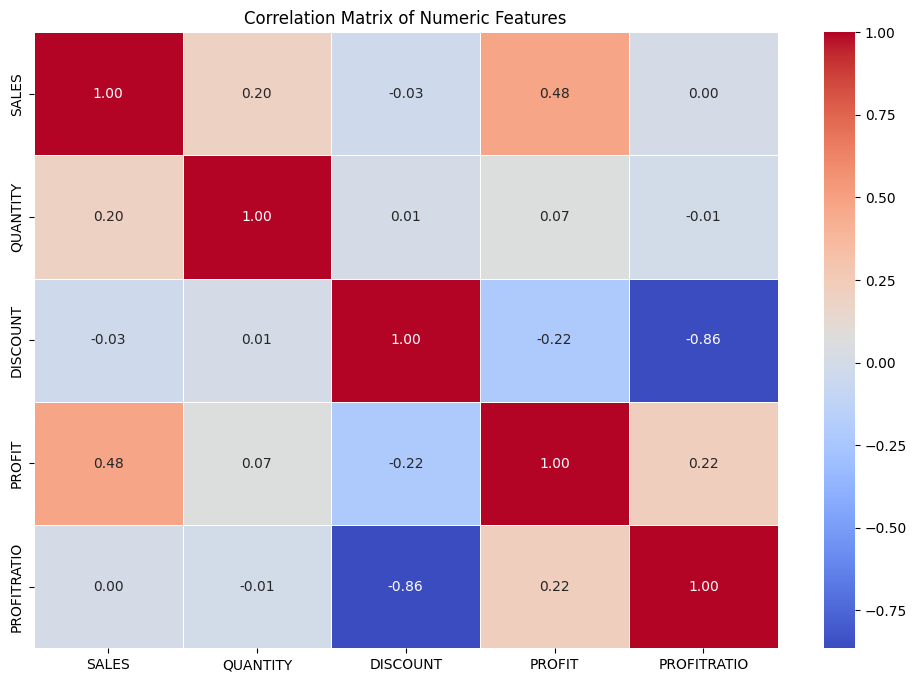

In [122]:
#correlation matrix
numeric_data = order_data.select_dtypes(include=[np.number])

correlation_matrix = numeric_data.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix of Numeric Features")
plt.show()


In [123]:
#One hot encoding
for col in order_data.select_dtypes(include=['datetime', 'datetime64']):
    order_data[col] = order_data[col].astype(np.int64) 
X = pd.get_dummies(order_data.drop(['ORDERPROFITABLE'], axis ='columns'), dtype = int )
X



,SALES,QUANTITY,DISCOUNT,PROFIT,PROFITRATIO,SEGMENT_Consumer,SEGMENT_Corporate,SEGMENT_Home Office,CATEGORY_Furniture,CATEGORY_Office Supplies,...,STATE_Vermont,STATE_Virginia,STATE_Washington,STATE_West Virginia,STATE_Wisconsin,STATE_Wyoming,SHIPMODE_First Class,SHIPMODE_Same Day,SHIPMODE_Second Class,SHIPMODE_Standard Class
0,16.0,2,0.2,6.0,33.8,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
1,12.0,3,0.2,4.0,36.3,0,0,1,0,1,...,0,0,0,0,0,0,0,0,0,1
2,4.0,2,0.8,-5.0,-155.0,0,0,1,0,1,...,0,0,0,0,0,0,0,0,0,1
3,273.0,3,0.2,-65.0,-23.8,0,0,1,0,1,...,0,0,0,0,0,0,0,0,0,1
4,20.0,3,0.2,5.0,25.0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9988,14.0,2,0.2,5.0,32.5,0,1,0,0,1,...,0,0,0,0,0,0,0,0,0,1
9989,21.0,2,0.2,6.0,31.3,0,1,0,0,1,...,0,0,0,0,0,0,0,0,0,1
9990,3.0,3,0.2,-1.0,-20.0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
9991,53.0,3,0.2,20.0,37.5,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1


In [124]:
#Label Encoding
le = LabelEncoder()
y = le.fit_transform(order_data['ORDERPROFITABLE'])
y

array([1, 1, 0, ..., 0, 1, 1], dtype=int64)

In [125]:
#Standardization
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [126]:
#Model training
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42)
model = RandomForestClassifier(n_estimators=100,random_state=42,max_depth=10000000)
model.fit(X_train,y_train)

RandomForestClassifier(max_depth=10000000, random_state=42)

In [127]:
#Evaluation matrix
y_predict = model.predict(X_test)
print("Accuracy:", accuracy_score(y_test, y_predict))
print("\nClassification Report:")
print(classification_report(y_test, y_predict))

Accuracy: 1.0

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       614
           1       1.00      1.00      1.00      2384

    accuracy                           1.00      2998
   macro avg       1.00      1.00      1.00      2998
weighted avg       1.00      1.00      1.00      2998



### 4. Cluster Orders by Buying Behavior

In [128]:
def load_cluster_data():
    df = fact_sales \
        .join(dim_customer, fact_sales["CUSTOMERKEY"] == dim_customer["CUSTOMERKEY"]) \
        .join(dim_product, fact_sales["PRODUCTKEY"] == dim_product["PRODUCTKEY"]) \
        .join(dim_shipping, fact_sales["SHIPMODEKEY"] == dim_shipping["SHIPMODEKEY"]) \
        .join(dim_location, fact_sales["LOCATIONKEY"] == dim_location["LOCATIONKEY"]) \
        .select(
            fact_sales["SALES"],
            fact_sales["QUANTITY"],
            fact_sales["DISCOUNT"],
            fact_sales["PROFIT"],
            dim_customer["CUSTOMERKEY"]
        )

    return df.to_pandas()


In [129]:
cluster_data = load_cluster_data()

In [130]:
cluster_data

,SALES,QUANTITY,DISCOUNT,PROFIT,r_0105_CUSTOMERKEY
0,16.0,2,0.2,6.0,1
1,12.0,3,0.2,4.0,2
2,4.0,2,0.8,-5.0,2
3,273.0,3,0.2,-65.0,2
4,20.0,3,0.2,5.0,3
...,...,...,...,...,...
9988,14.0,2,0.2,5.0,725
9989,21.0,2,0.2,6.0,725
9990,3.0,3,0.2,-1.0,738
9991,53.0,3,0.2,20.0,97


In [131]:
#Clean column names
cluster_data.columns = [col.split('_')[-1] if '_' in col else col for col in cluster_data.columns]
cluster_data.columns

Index(['SALES', 'QUANTITY', 'DISCOUNT', 'PROFIT', 'CUSTOMERKEY'], dtype='object')

In [132]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns

In [133]:
cluster_df = cluster_data.groupby('CUSTOMERKEY').agg({
    'SALES': ['sum', 'mean', 'count'],
    'DISCOUNT': 'mean',
    'QUANTITY': 'mean',
    'PROFIT': 'mean',

}).reset_index()

In [134]:
# Rename columns
cluster_df.columns = ['CUSTOMERKEY', 'TOTAL_SALES', 'AVG_SALE', 'PURCHASE_COUNT',
                         'AVG_PROFIT', 'AVG_DISCOUNT', 'AVG_QUANTITY']

In [135]:
X = cluster_df.drop('CUSTOMERKEY', axis=1)

In [136]:
# Standardization
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

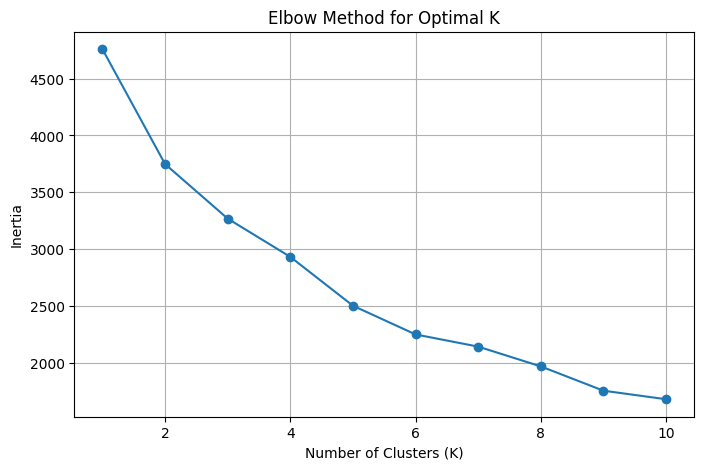

In [137]:
# Find etermine optimal k
inertia = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)

# Plot Elbow curve
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), inertia, marker='o')
plt.title('Elbow Method for Optimal K')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()


In [138]:

optimal_k = 3

In [139]:
# KMeans clustering
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
labels = kmeans.fit_predict(X_scaled)
cluster_df['CLUSTER'] = labels

In [140]:
# PCA
pca = PCA(n_components=2)
pca_X = pca.fit_transform(X_scaled)

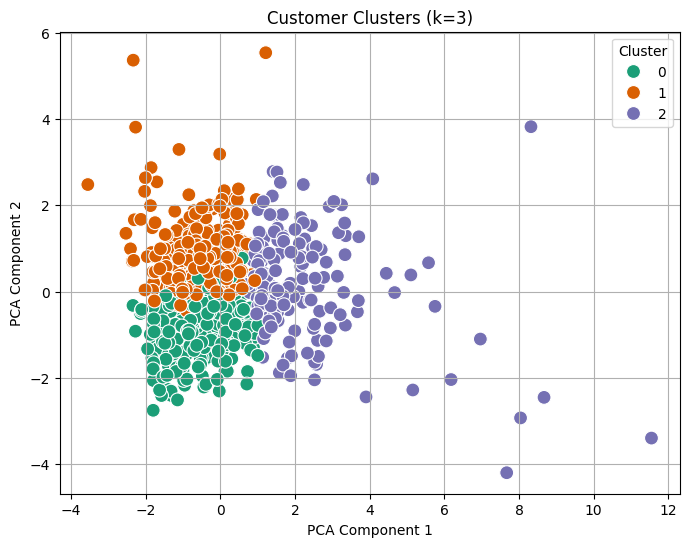

In [141]:
# Scatter plot of clusters using PCA components
plt.figure(figsize=(8, 6))
sns.scatterplot(x=pca_X[:, 0], y=pca_X[:, 1], hue=labels, palette='Dark2', s=100)
plt.title(f'Customer Clusters (k={optimal_k})')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

### 5. Visualize shipment performance across geographies 

In [142]:
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

In [143]:
def load_geo_data():
    df = fact_sales.join(dim_shipping, fact_sales["SHIPMODEKEY"] == dim_shipping["SHIPMODEKEY"]) \
                   .join(dim_location, fact_sales["LOCATIONKEY"] == dim_location["LOCATIONKEY"]) \
                   .select(
                        fact_sales["FACTID"],
                        fact_sales["SALES"],
                        fact_sales['PROFIT'],
                        fact_sales['QUANTITY'],
                        fact_sales['DISCOUNT'],
                        dim_shipping["SHIPMODE"],
                        dim_shipping["SHIPSTATUS"],
                        dim_shipping["DAYSTOSHIPACTUAL"],
                        dim_shipping["DAYSTOSHIPSCHEDULED"],
                        dim_location["REGION"],
                        dim_location["COUNTRY"],
                        dim_location["STATE"],
                        dim_location["CITY"],
                        dim_location["LATITUDE"],
                        dim_location["LONGITUDE"]
                    )

    df_pd = df.to_pandas()

    # Calculate shipping delay
    df_pd["SHIPPINGDELAY"] = df_pd["DAYSTOSHIPACTUAL"] - df_pd["DAYSTOSHIPSCHEDULED"]

    return df_pd


In [144]:
geog_data = load_geo_data()
geog_data

,FACTID,SALES,PROFIT,QUANTITY,DISCOUNT,SHIPMODE,SHIPSTATUS,DAYSTOSHIPACTUAL,DAYSTOSHIPSCHEDULED,REGION,COUNTRY,STATE,CITY,LATITUDE,LONGITUDE,SHIPPINGDELAY
0,1,16.0,6.0,2,0.2,Standard Class,Shipped Early,4,6,Central,United States,Texas,Houston,29.8941,-95.6481,-2
1,2,12.0,4.0,3,0.2,Standard Class,Shipped Early,4,6,Central,United States,Illinois,Naperville,41.7662,-88.1410,-2
2,3,4.0,-5.0,2,0.8,Standard Class,Shipped Early,4,6,Central,United States,Illinois,Naperville,41.7662,-88.1410,-2
3,4,273.0,-65.0,3,0.2,Standard Class,Shipped Early,4,6,Central,United States,Illinois,Naperville,41.7662,-88.1410,-2
4,5,20.0,5.0,3,0.2,Standard Class,Shipped Late,7,6,East,United States,Pennsylvania,Philadelphia,39.9448,-75.2288,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9988,13353,14.0,5.0,2,0.2,Standard Class,Shipped Early,4,6,West,United States,California,Fairfield,38.2671,-122.0357,-2
9989,13354,21.0,6.0,2,0.2,Standard Class,Shipped Early,4,6,West,United States,California,Fairfield,38.2671,-122.0357,-2
9990,13355,3.0,-1.0,3,0.2,Standard Class,Shipped Early,4,6,West,United States,Colorado,Loveland,40.4262,-105.0900,-2
9991,13356,53.0,20.0,3,0.2,Standard Class,Shipped Early,4,6,East,United States,New York,New York City,40.7262,-73.9796,-2


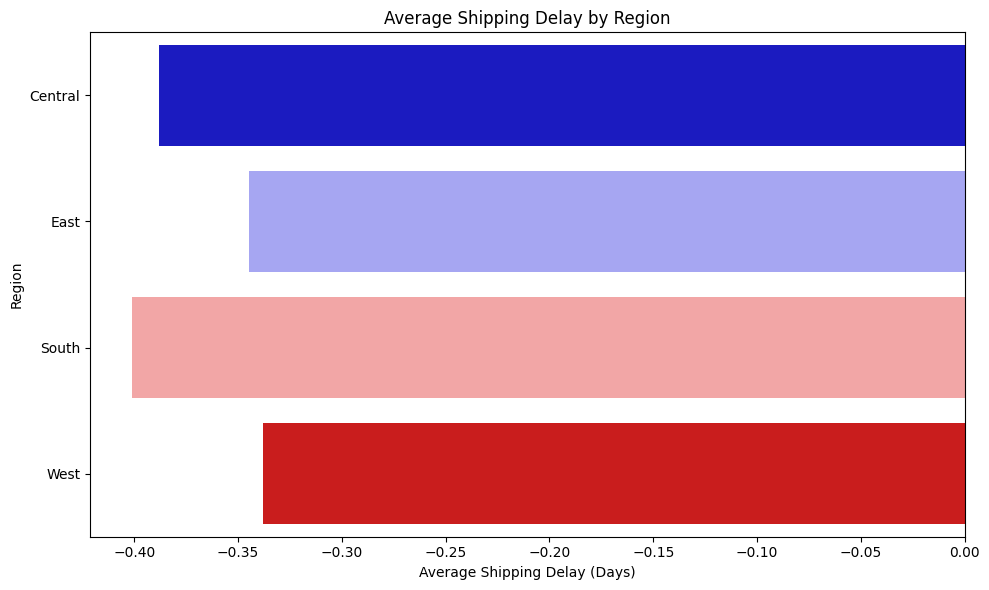

In [145]:
#Average Shipping Delay by Region

region_delay = geog_data.groupby("REGION")["SHIPPINGDELAY"].mean().reset_index()

plt.figure(figsize=(10,6))
sns.barplot(x="SHIPPINGDELAY", y="REGION", data=region_delay, hue="REGION", palette="seismic", legend=False)
plt.title("Average Shipping Delay by Region")
plt.xlabel("Average Shipping Delay (Days)")
plt.ylabel("Region")
plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

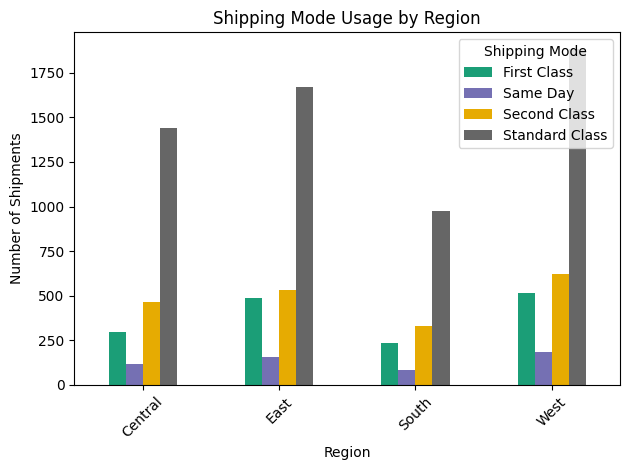

In [146]:
#Shipping Mode Usage by Regio
plt.figure(figsize=(12, 6))
mode_usage = geog_data.groupby(['REGION', 'SHIPMODE']).size().unstack().fillna(0)
mode_usage.plot(kind='bar', stacked=False, colormap='Dark2')
plt.title('Shipping Mode Usage by Region')
plt.xlabel('Region')
plt.ylabel('Number of Shipments')
plt.xticks(rotation=45)
plt.legend(title='Shipping Mode')
plt.tight_layout()
plt.show()

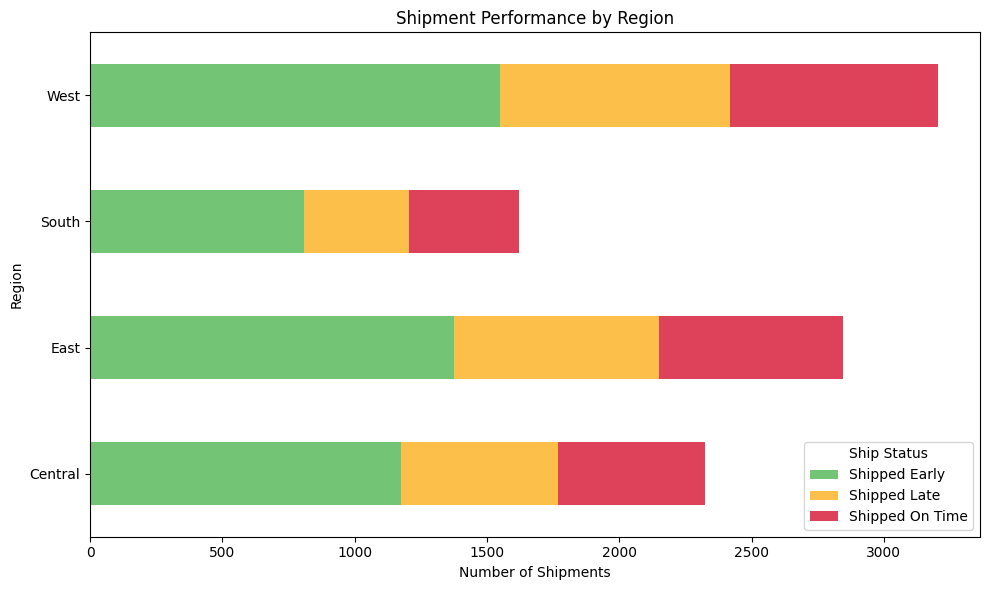

In [147]:
#Shipment Performance by Region
geog_data['SHIPSTATUS'] = geog_data['SHIPSTATUS'].str.strip().str.title()

shipment_counts = geog_data.groupby(['REGION', 'SHIPSTATUS']).size().unstack(fill_value=0)

shipment_counts.plot(kind='barh', stacked=True, figsize=(10, 6), color=['#74c476', '#fcbf49', '#de425b'])

plt.title('Shipment Performance by Region')
plt.xlabel('Number of Shipments')
plt.ylabel('Region')
plt.legend(title='Ship Status')
plt.tight_layout()
plt.show()


In [148]:
import folium
from folium.plugins import MarkerCluster

In [149]:
center_lat = geog_data['LATITUDE'].mean()
center_lon = geog_data['LONGITUDE'].mean()
map_view = folium.Map(location=[center_lat, center_lon], zoom_start=5)

marker_cluster = MarkerCluster().add_to(map_view)

def get_marker_color(delay):
    if delay <= 0:
        return 'green'
    elif delay <= 3:
        return 'orange'
    else:
        return 'red'

for _, row in geog_data.iterrows():
    folium.Marker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        popup=folium.Popup(f"<b>City:</b> {row['CITY']}<br><b>Delay:</b> {row['SHIPPINGDELAY']} days<br><b>Status:</b> {row['SHIPSTATUS']}", max_width=300),
        tooltip=row['CITY'],
        icon=folium.Icon(color=get_marker_color(row['SHIPPINGDELAY']))
    ).add_to(marker_cluster)

map_view


### 5. Analyze delivery delays or profit trends by latitude/longitude 

In [150]:
import geopandas as gpd

In [151]:
def load_data_5():
    fact_sales = session.table("FACTSALES")
    dim_date = session.table("DIMDATE")
    dim_customer = session.table("DIMCUSTOMER")
    dim_product = session.table("DIMPRODUCT")
    dim_shipping = session.table("DIMSHIPPING")
    dim_location = session.table("DIMLOCATION")

    df = fact_sales.join(dim_date, fact_sales["ORDERDATEKEY"] == dim_date["DATEKEY"]) \
                   .join(dim_customer, fact_sales["CUSTOMERKEY"] == dim_customer["CUSTOMERKEY"]) \
                   .join(dim_product, fact_sales["PRODUCTKEY"] == dim_product["PRODUCTKEY"]) \
                   .join(dim_shipping, fact_sales["SHIPMODEKEY"] == dim_shipping["SHIPMODEKEY"]) \
                   .join(dim_location, fact_sales["LOCATIONKEY"] == dim_location["LOCATIONKEY"]) \
                   .select(
                        fact_sales["SALES"],  
                        fact_sales["PROFIT"],  
                        fact_sales["QUANTITY"],  
                        fact_sales["DISCOUNT"],  
                        fact_sales["PROFITRATIO"],
                        dim_shipping["SHIPMODE"],  
                        dim_shipping["SHIPSTATUS"],  
                        dim_shipping["DAYSTOSHIPACTUAL"],  
                        dim_shipping["DAYSTOSHIPSCHEDULED"],  
                        dim_product["CATEGORY"],  
                        dim_customer["SEGMENT"],  
                        dim_date["YEAR"],  
                        dim_date["MONTH"],  
                        dim_location["REGION"],  
                        dim_location["STATE"],  
                        dim_location["LATITUDE"],  
                        dim_location["LONGITUDE"],
                        dim_location["CITY"]

                    )


    df_pd = df.to_pandas()

    df_pd["SHIPPINGDELAY"] = df_pd["DAYSTOSHIPACTUAL"] - df_pd["DAYSTOSHIPSCHEDULED"]

    return df_pd

In [152]:
data = load_data_5()
data

,SALES,PROFIT,QUANTITY,DISCOUNT,PROFITRATIO,SHIPMODE,SHIPSTATUS,DAYSTOSHIPACTUAL,DAYSTOSHIPSCHEDULED,CATEGORY,SEGMENT,YEAR,MONTH,REGION,STATE,LATITUDE,LONGITUDE,CITY,SHIPPINGDELAY
0,16.0,6.0,2,0.2,33.8,Standard Class,Shipped Early,4,6,Office Supplies,Consumer,2011,1,Central,Texas,29.8941,-95.6481,Houston,-2
1,12.0,4.0,3,0.2,36.3,Standard Class,Shipped Early,4,6,Office Supplies,Home Office,2011,1,Central,Illinois,41.7662,-88.1410,Naperville,-2
2,4.0,-5.0,2,0.8,-155.0,Standard Class,Shipped Early,4,6,Office Supplies,Home Office,2011,1,Central,Illinois,41.7662,-88.1410,Naperville,-2
3,273.0,-65.0,3,0.2,-23.8,Standard Class,Shipped Early,4,6,Office Supplies,Home Office,2011,1,Central,Illinois,41.7662,-88.1410,Naperville,-2
4,20.0,5.0,3,0.2,25.0,Standard Class,Shipped Late,7,6,Office Supplies,Consumer,2011,1,East,Pennsylvania,39.9448,-75.2288,Philadelphia,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9988,14.0,5.0,2,0.2,32.5,Standard Class,Shipped Early,4,6,Office Supplies,Corporate,2014,12,West,California,38.2671,-122.0357,Fairfield,-2
9989,21.0,6.0,2,0.2,31.3,Standard Class,Shipped Early,4,6,Office Supplies,Corporate,2014,12,West,California,38.2671,-122.0357,Fairfield,-2
9990,3.0,-1.0,3,0.2,-20.0,Standard Class,Shipped Early,4,6,Office Supplies,Consumer,2014,12,West,Colorado,40.4262,-105.0900,Loveland,-2
9991,53.0,20.0,3,0.2,37.5,Standard Class,Shipped Early,4,6,Office Supplies,Consumer,2014,12,East,New York,40.7262,-73.9796,New York City,-2


In [153]:
scaler = StandardScaler()
data[['LATITUDE', 'LONGITUDE']] = scaler.fit_transform(data[['LATITUDE', 'LONGITUDE']])

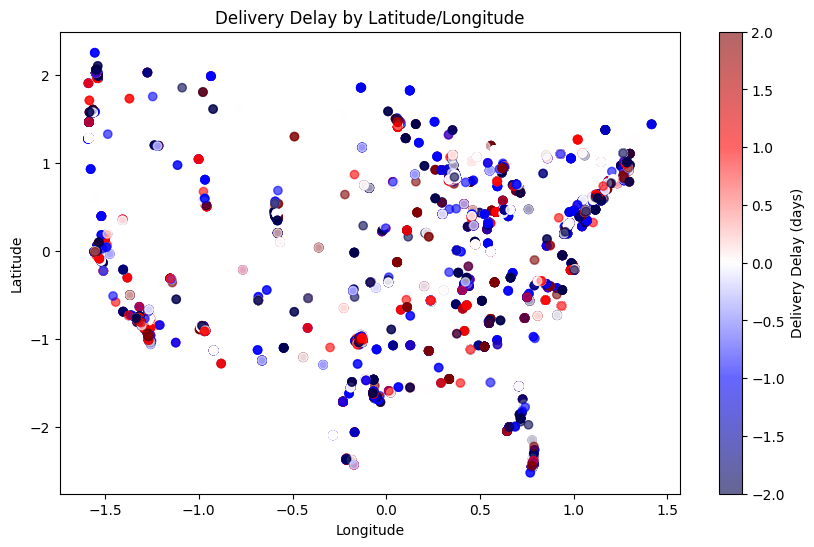

In [154]:
# Delivery Delay by Latitude/Longitude
plt.figure(figsize=(10, 6))
plt.scatter(data['LONGITUDE'], data['LATITUDE'], c=data['SHIPPINGDELAY'], cmap='seismic', alpha=0.6)
plt.colorbar(label='Delivery Delay (days)')
plt.title('Delivery Delay by Latitude/Longitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

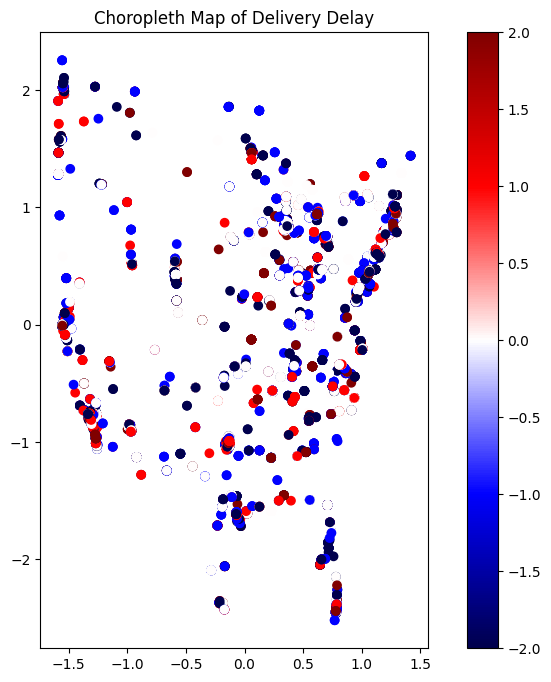

In [155]:
#Choropleth Map of Delivery Delay
gdf = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data['LONGITUDE'], data['LATITUDE']))

gdf.plot(column='SHIPPINGDELAY', cmap='seismic', legend=True, figsize=(10, 8))
plt.title('Choropleth Map of Delivery Delay')
plt.show()

In [156]:
#Profitability and Shipping Delay Trends by Location
new_data = data.groupby(['CITY', 'LATITUDE', 'LONGITUDE']).agg({
    'SHIPPINGDELAY': 'mean',
    'PROFIT': 'mean',
    'PROFITRATIO': 'mean'
}).reset_index()

new_data["ProfitSize"] = new_data["PROFIT"].abs()

fig = px.scatter_geo(
    new_data,
    lat="LATITUDE",
    lon="LONGITUDE",
    color="PROFIT",
    color_continuous_scale="RdYlGn",
    size="ProfitSize",
    size_max=25,
    hover_name="CITY",
    hover_data={
        "PROFIT": True,
        "SHIPPINGDELAY": True,
        "PROFITRATIO": True,
        "LATITUDE": False,
        "LONGITUDE": False
    },
    projection="natural earth",
    title="Profitability and Shipping Delay Trends by Location"
)

fig.update_layout(
    geo=dict(
        showland=True, landcolor="lightgrey",
        showcountries=True, countrycolor="white",
        showocean=True, oceancolor="lightblue"
    ),
    title_font_size=20
)

fig.show()


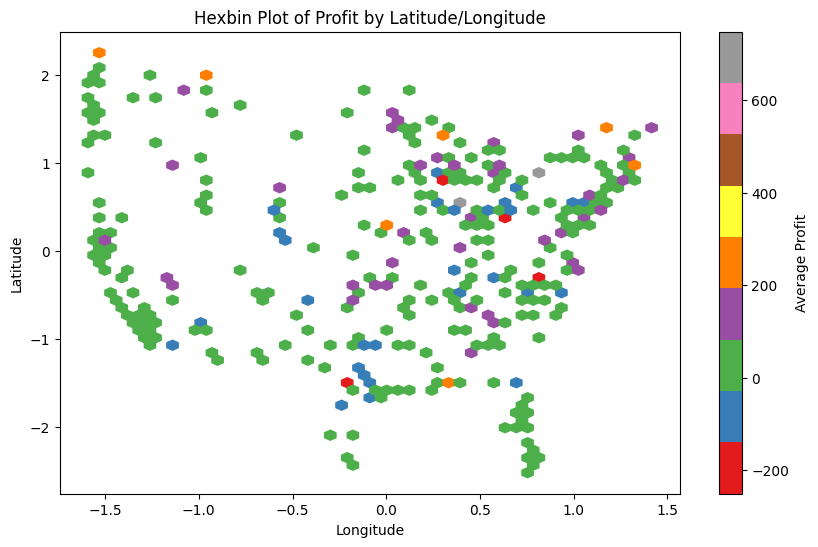

In [157]:
#Hexbin Plot of Profit by Latitude/Longitude
plt.figure(figsize=(10, 6))
hb = plt.hexbin(
    data['LONGITUDE'],
    data['LATITUDE'],
    C=data['PROFIT'],
    gridsize=50,
    cmap='Set1',
    reduce_C_function=np.mean,
    mincnt=1
)
plt.colorbar(hb, label='Average Profit')
plt.title('Hexbin Plot of Profit by Latitude/Longitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()